In [34]:
import json


In [35]:
root_dir = '/home/reza_voxelsafety_com/experiments/ergonomic/occluded_sample/syntheticdata2'
f = open('/home/reza_voxelsafety_com/experiments/ergonomic/occluded_sample/syntheticdata2/annotations.json')
data = json.load(f)
img_names = data['images']
print(f"number of images in the dataset {len(img_names)}")

number of images in the dataset 550


In [36]:
print(len(data['annotations']))

2750


In [37]:
print(img_names[0])

{'id': 0, 'file_name': 'image.000000.rgb.png', 'width': 1344, 'height': 760}


In [38]:
img_dict = {}
for name in img_names:
    img_dict[name['id']] = name['file_name']
print(img_dict)

{0: 'image.000000.rgb.png', 3: 'image.000001.rgb.png', 6: 'image.000002.rgb.png', 9: 'image.000003.rgb.png', 12: 'image.000004.rgb.png', 15: 'image.000005.rgb.png', 18: 'image.000006.rgb.png', 21: 'image.000007.rgb.png', 24: 'image.000008.rgb.png', 27: 'image.000009.rgb.png', 30: 'image.000010.rgb.png', 33: 'image.000011.rgb.png', 36: 'image.000012.rgb.png', 39: 'image.000013.rgb.png', 42: 'image.000014.rgb.png', 45: 'image.000015.rgb.png', 48: 'image.000016.rgb.png', 51: 'image.000017.rgb.png', 54: 'image.000018.rgb.png', 57: 'image.000019.rgb.png', 60: 'image.000020.rgb.png', 63: 'image.000021.rgb.png', 66: 'image.000022.rgb.png', 69: 'image.000023.rgb.png', 72: 'image.000024.rgb.png', 75: 'image.000025.rgb.png', 78: 'image.000026.rgb.png', 81: 'image.000027.rgb.png', 84: 'image.000028.rgb.png', 87: 'image.000029.rgb.png', 90: 'image.000030.rgb.png', 93: 'image.000031.rgb.png', 96: 'image.000032.rgb.png', 99: 'image.000033.rgb.png', 102: 'image.000034.rgb.png', 105: 'image.000035.rgb

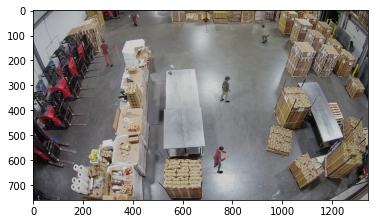

In [28]:
import matplotlib.pyplot as plt
from PIL import Image
import os
sample_image = Image.open(os.path.join(root_dir, img_names[0]['file_name']))
plt.imshow(sample_image)
plt.show()

In [29]:
import numpy as np
def _normalize_pose(keypoints):
        v = [keypoints[i] for i in range(len(keypoints)) if i%3==2]
        x = [keypoints[i] for i in range(len(keypoints)) if i%3==0]
        y = [keypoints[i] for i in range(len(keypoints)) if i%3==1]
        data_p = np.column_stack((x, y))
        data_p = np.delete(data_p,[3,4], axis = 0)
        data_p = data_p - data_p[11,:]

In [30]:
import os
import sys
sys.path.append(os.environ["BUILD_WORKSPACE_DIRECTORY"])
from core.perception.pose.api import FastPose, PoseModel

In [31]:
class PoseModelSyn(PoseModel):
    def __call__(self, frame, annotation):
        box = [annotation['bbox'][0],
        annotation['bbox'][1],
        annotation['bbox'][0] + annotation['bbox'][2], 
        annotation['bbox'][1] + annotation['bbox'][3]]
        boxes = []
        boxes.append(box)
        boxes = torch.from_numpy(np.asarray(boxes))
        scores = []
        scores.append(1)
        scores = torch.from_numpy(np.asarray(scores))
        results = (
            self._process(frame, boxes, scores) if boxes is not None else []
        )

        for result in results:
            pose = self._get_pose_from_result(result)
        return pose


In [32]:
keypoints = [
            "nose",
            "left_eye",
            "right_eye",
            "left_ear",
            "right_ear",
            "left_shoulder",
            "right_shoulder",
            "left_elbow",
            "right_elbow",
            "left_wrist",
            "right_wrist",
            "left_hip",
            "right_hip",
            "left_knee",
            "right_knee",
            "left_ankle",
            "right_ankle"
            ]
print(keypoints)

['nose', 'left_eye', 'right_eye', 'left_ear', 'right_ear', 'left_shoulder', 'right_shoulder', 'left_elbow', 'right_elbow', 'left_wrist', 'right_wrist', 'left_hip', 'right_hip', 'left_knee', 'right_knee', 'left_ankle', 'right_ankle']


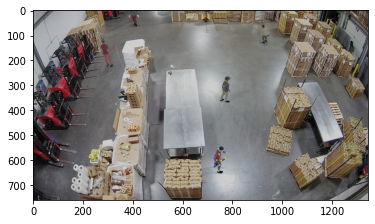

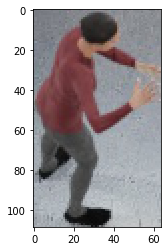

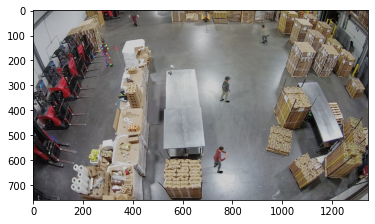

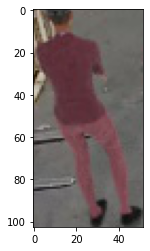

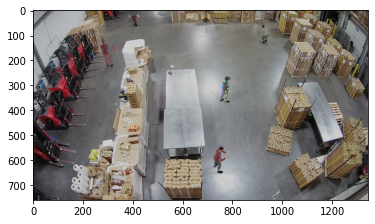

...

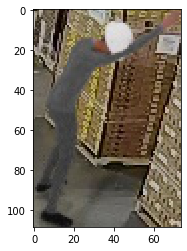

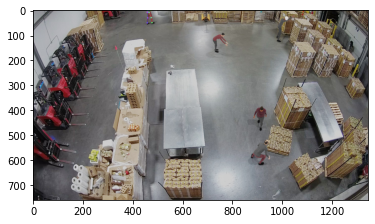

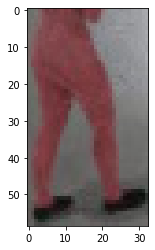

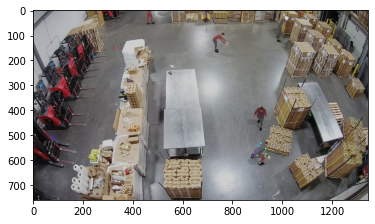

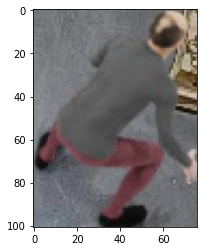

KeyboardInterrupt: 

In [39]:
annotations = data['annotations']
annotations_new = []
import numpy as np
import torch
import cv2
for anno in annotations:
    keypoints_model = []
    img_name = img_dict[anno['image_id']]
    sample_image = Image.open(os.path.join(root_dir, img_name))
    pose_model = PoseModelSyn('/home/reza_voxelsafety_com/experiments/ergonomic/model/fast_res50_256x192.pth')
    if anno['category_id'] == 0:
        #print(f"keypoints: {anno['keypoints']}")
        box = anno['bbox']
        img_array = np.asarray(sample_image)[...,:3]
        #temp = cv2.cvtColor(np.ascontiguousarray(temp), cv2.COLOR_RGB2BGR)
        pose = pose_model(img_array, anno)
        img_draw = pose.draw(np.ascontiguousarray(img_array))
        plt.imshow(img_draw)
        plt.show()
        model_output = pose.to_dict()
        #print(f"pose type: {pose.to_dict()['nose']}")
        for keyp in keypoints:
            keypoints_model.append(model_output[keyp]['x'])
            keypoints_model.append(model_output[keyp]['y'])
            keypoints_model.append(2)
        actor_img = sample_image.crop((box[0], box[1], box[0] + box[2], box[1] + box[3]))
        plt.imshow(actor_img)
        plt.show() 
        anno['keypoints'] = keypoints_model
        #print(keypoints_model)
        annotations_new.append(anno)
        pose = anno['pose_category'] + anno['pose_subcategory']
#         print(pose)
#         input()
data['annotations'] = annotations_new
# with open('/home/reza_voxelsafety_com/experiments/ergonomic/syntheticdata/annotations_model.json', 'w') as f:
#     json.dump(data, f)

In [39]:
import torch
from torch.utils.data import Dataset

In [88]:
from torch.utils.data import Dataset, DataLoader
import torch
class PoseDataset(Dataset):
    
    def __init__(self, data_dir = None):
        self._data_dir = data_dir
        data_dirs = [x[0] for x in os.walk(self._data_dir)][1:]
        annotations = []
        for i in range(0,len(A)):
            annotation = json.load(open(f"{A[i]}/annotations.json"))['annotations']
            annotations.extend(annotation)
        self._annotations_person = [ano for ano in annotations if ano['category_id'] == 0]
        self._pose_dict = {"liftingbad": 0, "liftinggood": 1, "reachingbad": 2, "reachinggood": 3, 'randomrandom': 4}

    def _process_pose(self, pose):
        return self._pose_dict[pose]
    
    def _normalize_pose(self,keypoints):
        x = [keypoints[i] for i in range(len(keypoints)) if i%3==0]
        y = [keypoints[i] for i in range(len(keypoints)) if i%3==1]
        v = [keypoints[i] for i in range(len(keypoints)) if i%3==2]
        data_p = np.column_stack((x, y))
        data_p = np.delete(data_p,[3,4], axis = 0)
        data_p = data_p - data_p[11,:]
        return data_p
        
    def __getitem__(self, idx):
        actor = self._annotations_person[idx]
        x = torch.tensor(self._normalize_pose(actor['keypoints']))
        pose = actor['pose_category'] + actor['pose_subcategory']
        y = self._process_pose(pose)
        return x, y
    def __len__(self):
        return len(self._annotations_person)
    

In [89]:
pose_data = PoseDataset(data_dir = '/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/')

In [90]:
print(len(pose_data))

59893


In [91]:
dataloader = DataLoader(pose_data, batch_size=15, shuffle=False, num_workers=8)

In [92]:
for x, y in dataloader:
    print(x.shape)
    print(y.shape)
    break

torch.Size([15, 15, 2])
torch.Size([15])


In [22]:
import numpy as np
import torch
import cv2
import csv
import json
import os
import matplotlib.pyplot as plt
from PIL import Image
import random
k = 0
csv_file =  open("syn.csv", 'w')
csv_writer = csv.writer(csv_file, delimiter=",")

root_dir = '/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/'
data_dirs = [x[0] for x in os.walk(root_dir)][1:]
random_idx = random.sample(range(0, 59000), 5000)
for i in range(len(data_dirs)):
    print(data_dirs[i])
    data = json.load(open(f"{data_dirs[i]}/annotations.json"))
    img_dict = {}
    for name in data['images']:
        img_dict[name['id']] = name['file_name']
    annotations = data['annotations']
    annotations_new = []
    for anno in annotations:
        #keypoints_model = []
        img_name = img_dict[anno['image_id']]
        sample_image = Image.open(os.path.join(data_dirs[i], img_name))
        if anno['category_id'] == 0:
#             print(f"keypoints: {anno['keypoints']}")
            box = anno['bbox']
            if k in random_idx:
                img_array = np.asarray(sample_image)[...,:3]
                actor_img = sample_image.crop((box[0], box[1], box[0] + box[2], box[1] + box[3]))
                folder = data_dirs[i].split('/')[-1]
                actor_img.save(f"/home/reza_voxelsafety_com/voxel/experimental/reza/Ergonomic/temp/{folder}_{anno['image_id']}_{anno['id']}.png")
                csv_writer.writerow([f"/home/reza_voxelsafety_com/voxel/experimental/reza/Ergonomic/{folder}_{anno['image_id']}_{anno['id']}.png", anno['pose_category'] + anno['pose_subcategory']])
            k = k + 1
csv_file.close()

/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-bloomingdale-0002
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-bloomingdale-0005
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-pooler-0004
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_uscold-laredo-dock01
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-pooler-0008
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-pooler-0007
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-bloomingdale-0007
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-bloomingdale-0006
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-savannah-bloomingdale-0004
/home/reza_voxelsafety_com/experiments/ergonomic/ergonomic-Infinity/_americold-s

In [17]:
random_idx  = random.sample(range(0, 59000), 10)

In [18]:
print(random_idx)

[16910, 34461, 27140, 15934, 49365, 58219, 42509, 52529, 3511, 12019]
